In [39]:
import pandas as pd
import numpy as np
import pyedflib
import os
import shutil
import glob
import datetime
from matplotlib import pyplot as plt

In [40]:
# Read raw PPG files

mdf = pd.read_csv(r'prof_data\resteaze\00011970-resteaze-sync.csv', sep=',')
mdf.head()

,Unnamed: 0,counter,unixTimes,accelerometerX,accelerometerY,accelerometerZ,capacitorsA,capacitorsB,capacitorsC,gyroscopeX,...,sleep_state,Leg Movement,Hypopnea,Arousal,RERA,Relative Desaturation,Obstructive Apnea,Central Apnea,Leg Movement (L),Leg Movement (R)
0,2829,2850,1647149354000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,-1.0,0,0,0,0,0,0,0,0,0
1,2830,2846,1647149354039,4045.0,-510.0,-464.0,32373.0,NaN,NaN,-129.0,...,-1.0,0,0,0,0,0,0,0,0,0
2,2831,2851,1647149354040,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,-1.0,0,0,0,0,0,0,0,0,0
3,2832,2852,1647149354080,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,-1.0,0,0,0,0,0,0,0,0,0
4,2833,2847,1647149354080,4044.0,-502.0,-443.0,32374.0,NaN,NaN,-138.0,...,-1.0,0,0,0,0,0,0,0,0,0


In [41]:
mdf = mdf.apply(lambda x: pd.Series(x.dropna().values))

In [42]:
all_df = mdf[mdf.sleep_state != -1].reset_index()

all_df = all_df[[
    'unixTimes', 'accelerometerX', 'accelerometerY', 'accelerometerZ',
    'gyroscopeX', 'gyroscopeY', 'gyroscopeZ', 'ledGreen',
    'sleep_stage', 'sleep_state'
]].dropna()

# Binary Classification
all_df["sleep_state"] = np.where(all_df["sleep_state"] == 0, 0, 1)


In [43]:
from sklearn.preprocessing import StandardScaler, LabelEncoder
from numpy import mean, sqrt, square, arange

# RMS of accelerometer
all_df['accelerometer'] = all_df[[
    'accelerometerX', 'accelerometerY', 'accelerometerZ'
]].apply(lambda x: sqrt(square(x['accelerometerX']) + square(x['accelerometerY']) + square(x['accelerometerZ'])), axis=1)

# RMS of gyroscope
all_df['gyroscope'] = all_df[[
    'gyroscopeX', 'gyroscopeY', 'gyroscopeZ'
]].apply(lambda x: sqrt(square(x['gyroscopeX']) + square(x['gyroscopeY']) + square(x['gyroscopeZ'])), axis=1)

all_df = all_df.drop(columns=['accelerometerX', 'accelerometerY', 'accelerometerZ', 'gyroscopeX', 'gyroscopeY', 'gyroscopeZ'])

In [44]:
all_df

,unixTimes,ledGreen,sleep_stage,sleep_state,accelerometer,gyroscope
0,1647149504010,11682.0,WK,0,4015.816106,176.720118
1,1647149504010,11650.0,WK,0,4016.086030,164.987878
2,1647149504049,11641.0,WK,0,4013.521147,172.029067
3,1647149504050,11691.0,WK,0,4008.382342,176.278189
4,1647149504089,11735.0,WK,0,4023.821194,169.926455
...,...,...,...,...,...,...
484581,1647159118240,7148.0,N2,1,4191.892413,182.060430
484582,1647159118268,7436.0,N2,1,4190.047374,102.352333
484583,1647159118280,6935.0,N2,1,4182.932225,88.164619
484584,1647159118308,6559.0,N2,1,4188.764973,84.758480


In [45]:
X = all_df.drop(['unixTimes', 'sleep_stage', 'sleep_state'], axis = 1)
Y = all_df['sleep_state']
Y = LabelEncoder().fit_transform(Y)
X = StandardScaler().fit_transform(X)

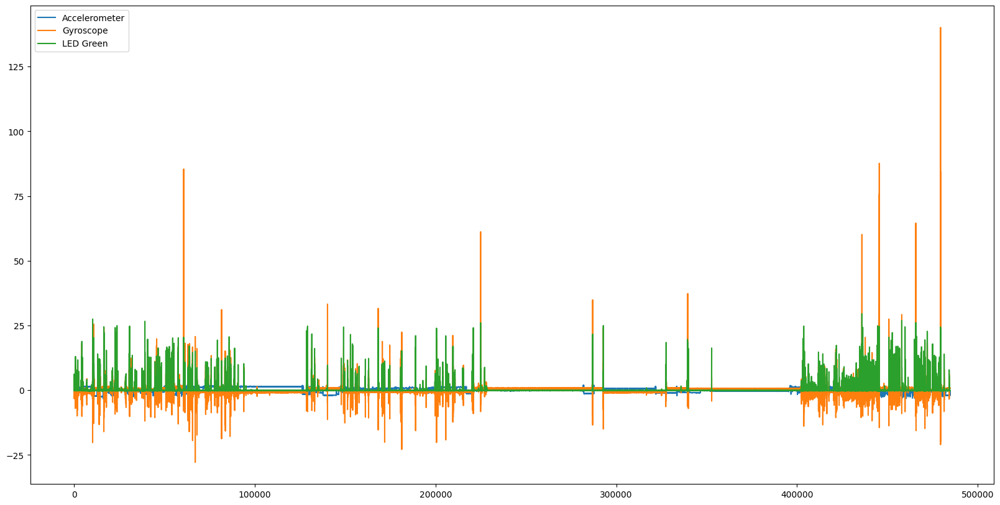

In [51]:
# plot the data

plt.figure(figsize=(20, 10))
plt.plot(X[:, 0], label='Accelerometer')
plt.plot(X[:, 1], label='Gyroscope')
plt.plot(X[:, 2], label='LED Green')
plt.legend()

In [55]:
import plotly.graph_objects as go

fig = go.Figure()

fig.add_trace(go.Line(y=X[:, 0], name='Accelerometer'))
fig.add_trace(go.Line(y=X[:, 1], name='Gyroscope'))
fig.add_trace(go.Line(y=X[:, 2], name='LED Green'))

fig.update_layout(title='Raw Data', xaxis_title='Time', yaxis_title='Value')

fig.show()

c:\Users\lucki\anaconda3\envs\tf\lib\site-packages\plotly\graph_objs\_deprecations.py:378: DeprecationWarning:

plotly.graph_objs.Line is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.scatter.Line
  - plotly.graph_objs.layout.shape.Line
  - etc.


